## EDA de producción eléctrica y precio en España 2015-2018

#### Autor: Antonio Romero Mtnez-Eiroa

### Introducción

En el presente informe se ofrece un análisis exploratorio de los datos relativos a la producción eléctrica en España y su
precio entre los años 2015 y 2018.

Estos datos comprenden básicamente información relativa a la cantidad de energía producida atendiendo a los distintos medios de generación, así como la producción total real y la esperada, y el precio real y el esperado. Toda esta información se desglosa por horas.

El objetivo de este análisis en conocer como se relaciona cada medio de generación con la producción total de energía y esta con el precio. 

### Carga de librerias
Se cargan las librerias necesarias para realizar el análisis exploratorio.

In [219]:
import numpy as np
import pandas as pd

from pandas_profiling import ProfileReport

import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt

%matplotlib inline

### Carga de datos
Se carga el dataframe que va a ser analizado en este informe.

In [220]:
energy = pd.read_csv('../data/energy_dataset.csv', delimiter = ',') 

### Tratamiento de datos
En primer lugar se carga el dataset para tener una idea visual de como se organiza. Puesto que no se muestra al completo, posteriormente se muestra el nombre de todas las variables.

In [221]:
energy

,time,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,...,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
0,2015-01-01 00:00:00+01:00,447.0,329.0,0.0,4844.0,4821.0,162.0,0.0,0.0,0.0,...,196.0,0.0,6378.0,17.0,NaN,6436.0,26118.0,25385.0,50.10,65.41
1,2015-01-01 01:00:00+01:00,449.0,328.0,0.0,5196.0,4755.0,158.0,0.0,0.0,0.0,...,195.0,0.0,5890.0,16.0,NaN,5856.0,24934.0,24382.0,48.10,64.92
2,2015-01-01 02:00:00+01:00,448.0,323.0,0.0,4857.0,4581.0,157.0,0.0,0.0,0.0,...,196.0,0.0,5461.0,8.0,NaN,5454.0,23515.0,22734.0,47.33,64.48
3,2015-01-01 03:00:00+01:00,438.0,254.0,0.0,4314.0,4131.0,160.0,0.0,0.0,0.0,...,191.0,0.0,5238.0,2.0,NaN,5151.0,22642.0,21286.0,42.27,59.32
4,2015-01-01 04:00:00+01:00,428.0,187.0,0.0,4130.0,3840.0,156.0,0.0,0.0,0.0,...,189.0,0.0,4935.0,9.0,NaN,4861.0,21785.0,20264.0,38.41,56.04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35059,2018-12-31 19:00:00+01:00,297.0,0.0,0.0,7634.0,2628.0,178.0,0.0,0.0,0.0,...,277.0,0.0,3113.0,96.0,NaN,3253.0,30619.0,30653.0,68.85,77.02
35060,2018-12-31 20:00:00+01:00,296.0,0.0,0.0,7241.0,2566.0,174.0,0.0,0.0,0.0,...,280.0,0.0,3288.0,51.0,NaN,3353.0,29932.0,29735.0,68.40,76.16
35061,2018-12-31 21:00:00+01:00,292.0,0.0,0.0,7025.0,2422.0,168.0,0.0,0.0,0.0,...,286.0,0.0,3503.0,36.0,NaN,3404.0,27903.0,28071.0,66.88,74.30
35062,2018-12-31 22:00:00+01:00,293.0,0.0,0.0,6562.0,2293.0,163.0,0.0,0.0,0.0,...,287.0,0.0,3586.0,29.0,NaN,3273.0,25450.0,25801.0,63.93,69.89


In [222]:
energy.columns

Index(['time', 'generation biomass', 'generation fossil brown coal/lignite',
       'generation fossil coal-derived gas', 'generation fossil gas',
       'generation fossil hard coal', 'generation fossil oil',
       'generation fossil oil shale', 'generation fossil peat',
       'generation geothermal', 'generation hydro pumped storage aggregated',
       'generation hydro pumped storage consumption',
       'generation hydro run-of-river and poundage',
       'generation hydro water reservoir', 'generation marine',
       'generation nuclear', 'generation other', 'generation other renewable',
       'generation solar', 'generation waste', 'generation wind offshore',
       'generation wind onshore', 'forecast solar day ahead',
       'forecast wind offshore eday ahead', 'forecast wind onshore day ahead',
       'total load forecast', 'total load actual', 'price day ahead',
       'price actual'],
      dtype='object')

Se cambia el nombre de las variables para hacerlos mas sencillos y manejables.

In [223]:
energy.columns = ['time', 'biomass', 'lignite', 'coal_dev_gas', 'gas', 'hard_coal', 'oil', 'oil_shale', 'peat', 
                  'geothermal', 'hydro_pumped_storage_aggregated', 'hydro_pumped_storage_consumption',
                  'hydro_run_river', 'hydro_water_reservoir', 'marine', 'nuclear', 'other',
                  'other_renewable', 'solar', 'waste', 'wind_offshore', 'wind_onshore', 'forecast_solar_day_ahead',
                  'forecast_wind_offshore_day_ahead', 'forecast_wind_onshore_day_ahead',
                  'total_load_forecast', 'total_load_actual', 'price_day_ahead',
                   'price_actual'] 

Se eliminan las variables vacias o que unicamente contienen 0 o están vacias. Para ello se realiza primero un sumatorio por variables y se descartan aquellas que suman 0.

In [224]:
energy.sum() 

time                                2015-01-01 00:00:00+01:002015-01-01 01:00:00+0...
biomass                                                                   1.34402e+07
lignite                                                                   1.57027e+07
coal_dev_gas                                                                        0
gas                                                                       1.97054e+08
hard_coal                                                                 1.49158e+08
oil                                                                       1.04546e+07
oil_shale                                                                           0
peat                                                                                0
geothermal                                                                          0
hydro_pumped_storage_aggregated                                                     0
hydro_pumped_storage_consumption                      

In [225]:
energy = energy.drop(['coal_dev_gas', 'oil_shale', 'peat', 'geothermal',
                           'hydro_pumped_storage_aggregated', 'marine', 'wind_offshore'], axis=1) 

Se eliminan variables relativas a la previsión de producción eléctrica de energías renovables, ya que no van a ser utilizadas.

In [226]:
energy = energy.drop(['forecast_solar_day_ahead', 'forecast_wind_offshore_day_ahead', 'forecast_wind_onshore_day_ahead'],
                     axis=1)                      

Puesto que la variable 'time' contiene información tanto de la fechacomo de la hora en una sola columna se divide en dos.
Para ellos se crea una nueva columna con los datos relativos únicamente a la fecha y otra con las información acerca de la hora. A partir de esta última columna se crea una nueva que contiene solamente la hora y se ignora la huso horario, puesto que todos los datos corresponden a un mismo país. 

Al terminar se eliminan tanto la columna 'time' original como la columna intermedia utilizada para la hora y se reordenan las variables para que las nuevas aprezcan al principio del dataset.

In [227]:
energy['time']  

0        2015-01-01 00:00:00+01:00
1        2015-01-01 01:00:00+01:00
2        2015-01-01 02:00:00+01:00
3        2015-01-01 03:00:00+01:00
4        2015-01-01 04:00:00+01:00
                   ...            
35059    2018-12-31 19:00:00+01:00
35060    2018-12-31 20:00:00+01:00
35061    2018-12-31 21:00:00+01:00
35062    2018-12-31 22:00:00+01:00
35063    2018-12-31 23:00:00+01:00
Name: time, Length: 35064, dtype: object

In [228]:
energy['date'] = energy.time.str.split(' ').str[0] 

In [229]:
energy['hour1'] = energy.time.str.split(' ').str[1] 

In [230]:
energy['hour'] = energy.hour1.str.split('+').str[0] 

In [231]:
energy = energy.drop(['time', 'hour1'], axis=1)  

In [232]:
energy = energy.reindex(columns = ['date', 'hour', 'biomass', 'lignite', 'gas', 'hard_coal', 'oil',
       'hydro_pumped_storage_consumption', 'hydro_run_river','hydro_water_reservoir', 'nuclear', 'other',
       'other_renewable', 'solar', 'waste', 'wind_onshore', 'total_load_forecast',
       'total_load_actual', 'price_day_ahead', 'price_actual']) 

In [233]:
energy.head() 

,date,hour,biomass,lignite,gas,hard_coal,oil,hydro_pumped_storage_consumption,hydro_run_river,hydro_water_reservoir,nuclear,other,other_renewable,solar,waste,wind_onshore,total_load_forecast,total_load_actual,price_day_ahead,price_actual
0,2015-01-01,00:00:00,447.0,329.0,4844.0,4821.0,162.0,863.0,1051.0,1899.0,7096.0,43.0,73.0,49.0,196.0,6378.0,26118.0,25385.0,50.10,65.41
1,2015-01-01,01:00:00,449.0,328.0,5196.0,4755.0,158.0,920.0,1009.0,1658.0,7096.0,43.0,71.0,50.0,195.0,5890.0,24934.0,24382.0,48.10,64.92
2,2015-01-01,02:00:00,448.0,323.0,4857.0,4581.0,157.0,1164.0,973.0,1371.0,7099.0,43.0,73.0,50.0,196.0,5461.0,23515.0,22734.0,47.33,64.48
3,2015-01-01,03:00:00,438.0,254.0,4314.0,4131.0,160.0,1503.0,949.0,779.0,7098.0,43.0,75.0,50.0,191.0,5238.0,22642.0,21286.0,42.27,59.32
4,2015-01-01,04:00:00,428.0,187.0,4130.0,3840.0,156.0,1826.0,953.0,720.0,7097.0,43.0,74.0,42.0,189.0,4935.0,21785.0,20264.0,38.41,56.04


Se observa la información relativa a las variables con las que se va a desarrollar el análisis.

In [234]:
energy.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35064 entries, 0 to 35063
Data columns (total 20 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   date                              35064 non-null  object 
 1   hour                              35064 non-null  object 
 2   biomass                           35045 non-null  float64
 3   lignite                           35046 non-null  float64
 4   gas                               35046 non-null  float64
 5   hard_coal                         35046 non-null  float64
 6   oil                               35045 non-null  float64
 7   hydro_pumped_storage_consumption  35045 non-null  float64
 8   hydro_run_river                   35045 non-null  float64
 9   hydro_water_reservoir             35046 non-null  float64
 10  nuclear                           35047 non-null  float64
 11  other                             35046 non-null  float64
 12  othe

Se observa en número de valores nulos, no son significativos.

In [235]:
energy.isnull().sum(axis=0) 

date                                 0
hour                                 0
biomass                             19
lignite                             18
gas                                 18
hard_coal                           18
oil                                 19
hydro_pumped_storage_consumption    19
hydro_run_river                     19
hydro_water_reservoir               18
nuclear                             17
other                               18
other_renewable                     18
solar                               18
waste                               19
wind_onshore                        18
total_load_forecast                  0
total_load_actual                   36
price_day_ahead                      0
price_actual                         0
dtype: int64

### Definición de las variables:
- __date__: fecha, en formato AAAA-MM-DD.
- __hour__: hora, en formato hh:mm:ss.
- __biomass__: producción electrica generada por biomasa en MW (megavatios).                           
- __lignite__: producción eléctrica generada por lignito en MW (megavatios).                                               
- __gas__: producción eléctrica generada por gas en MW (megavatios).
- __hard_coal__: producción eléctrica generada por gas en MW (megavatios).
- __oil__: producción eléctrica generada por petroleo en MW (megavatios).
- __hydro_pumped_storage_consumption__: producción eléctrica generada por centrales hidroeléctricas reversibles en             MW (megavatios).
- __hydro_run_river__: producción eléctrica generada por centrales hidroeléctricas de pasada en MW (megavatios).
- __hydro_water_reservoir__: producción eléctrica generada por centrales hidroeléctricas convencionales en MW (megavatios).
- __nuclear__: producción eléctrica generada por energía nuclear en MW (megavatios).                            
- __other__: producción eléctrica generada por otras fuentes de energía en MW (megavatios).                              
- __other_renewable__: producción electrica generada por otras fuentes de energía renovable en MW (megavatios).
- __solar__: producción eléctrica generada por energía solar en MW (megavatios).
- __waste__: producción eléctrica generada por aprovechamiento de residuos en MW (megavatios).                             
- __wind_onshore__: producción eléctrica generada por energía eólica terrestre en MW (megavatios).                      
- __total_load_forecast__: demanda eléctrica esperada en MW (megavatios).                 
- __total_load_actual__: demanda eléctrica real en MW (megavatios).                   
- __price_day_ahead__: precio esperado en EUR/MWh (megavatios por hora).                      
- __price_actual__: precio real en EUR/MWh (megavatios por hora).                          


### Analisis de datos

Se presenta una tabla con los estadísticos básicos de las variables.

In [236]:
energy.describe() 

,biomass,lignite,gas,hard_coal,oil,hydro_pumped_storage_consumption,hydro_run_river,hydro_water_reservoir,nuclear,other,other_renewable,solar,waste,wind_onshore,total_load_forecast,total_load_actual,price_day_ahead,price_actual
count,35045.000000,35046.000000,35046.000000,35046.000000,35045.000000,35045.000000,35045.000000,35046.000000,35047.000000,35046.000000,35046.000000,35046.000000,35045.000000,35046.000000,35064.000000,35028.000000,35064.000000,35064.000000
mean,383.513540,448.059208,5622.737488,4256.065742,298.319789,475.577343,972.116108,2605.114735,6263.907039,60.228585,85.639702,1432.665925,269.452133,5464.479769,28712.129962,28696.939905,49.874341,57.884023
std,85.353943,354.568590,2201.830478,1961.601013,52.520673,792.406614,400.777536,1835.199745,839.667958,20.238381,14.077554,1680.119887,50.195536,3213.691587,4594.100854,4574.987950,14.618900,14.204083
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18105.000000,18041.000000,2.060000,9.330000
25%,333.000000,0.000000,4126.000000,2527.000000,263.000000,0.000000,637.000000,1077.250000,5760.000000,53.000000,73.000000,71.000000,240.000000,2933.000000,24793.750000,24807.750000,41.490000,49.347500
50%,367.000000,509.000000,4969.000000,4474.000000,300.000000,68.000000,906.000000,2164.000000,6566.000000,57.000000,88.000000,616.000000,279.000000,4849.000000,28906.000000,28901.000000,50.520000,58.020000
75%,433.000000,757.000000,6429.000000,5838.750000,330.000000,616.000000,1250.000000,3757.000000,7025.000000,80.000000,97.000000,2578.000000,310.000000,7398.000000,32263.250000,32192.000000,60.530000,68.010000
max,592.000000,999.000000,20034.000000,8359.000000,449.000000,4523.000000,2000.000000,9728.000000,7117.000000,106.000000,119.000000,5792.000000,357.000000,17436.000000,41390.000000,41015.000000,101.990000,116.800000


Se realiza un breve resumen de un análisis de datos para tener una idea inicial de las variables.

In [237]:
resumen_eda = ProfileReport(energy,title="EDA energy") 
resumen_eda

array([[<AxesSubplot:title={'center':'biomass'}>,
        <AxesSubplot:title={'center':'lignite'}>,
        <AxesSubplot:title={'center':'gas'}>,
        <AxesSubplot:title={'center':'hard_coal'}>],
       [<AxesSubplot:title={'center':'oil'}>,
        <AxesSubplot:title={'center':'hydro_pumped_storage_consumption'}>,
        <AxesSubplot:title={'center':'hydro_run_river'}>,
        <AxesSubplot:title={'center':'hydro_water_reservoir'}>],
       [<AxesSubplot:title={'center':'nuclear'}>,
        <AxesSubplot:title={'center':'other'}>,
        <AxesSubplot:title={'center':'other_renewable'}>,
        <AxesSubplot:title={'center':'solar'}>],
       [<AxesSubplot:title={'center':'waste'}>,
        <AxesSubplot:title={'center':'wind_onshore'}>,
        <AxesSubplot:title={'center':'total_load_forecast'}>,
        <AxesSubplot:title={'center':'total_load_actual'}>],
       [<AxesSubplot:title={'center':'price_day_ahead'}>,
        <AxesSubplot:title={'center':'price_actual'}>, <AxesSubplot:

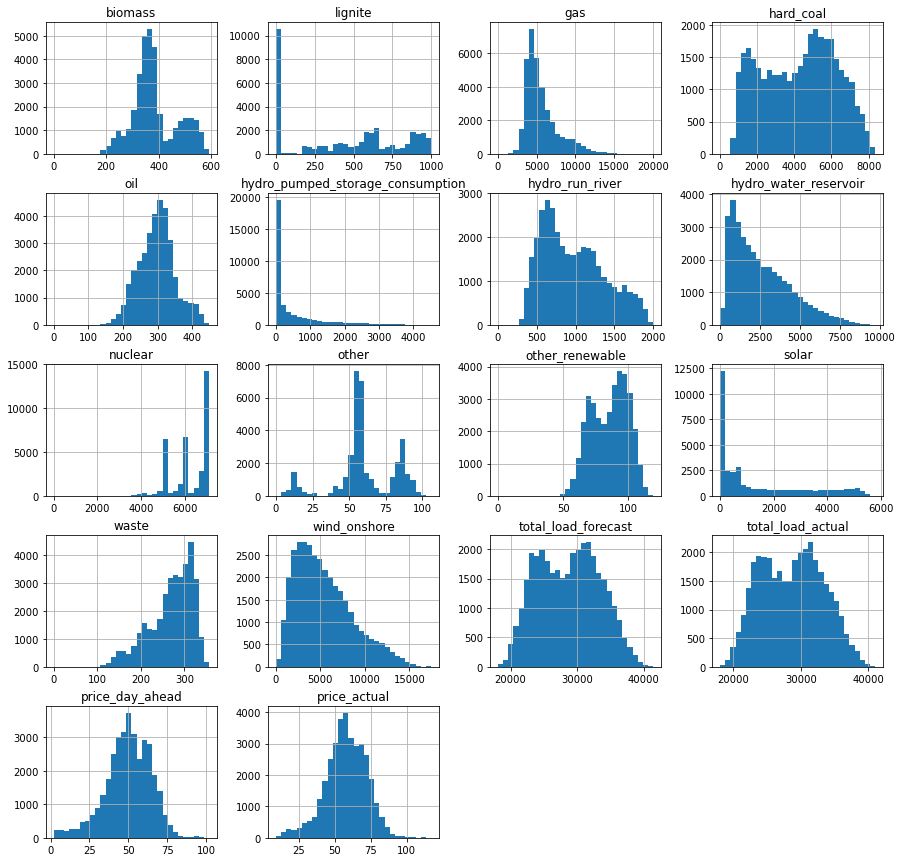

In [238]:
energy.hist(figsize = (15, 15), bins = 30) 

In [239]:
energy.corr() 

,biomass,lignite,gas,hard_coal,oil,hydro_pumped_storage_consumption,hydro_run_river,hydro_water_reservoir,nuclear,other,other_renewable,solar,waste,wind_onshore,total_load_forecast,total_load_actual,price_day_ahead,price_actual
biomass,1.000000,0.229809,-0.021660,0.433522,0.459530,-0.044898,-0.284877,-0.033675,-0.021279,0.658488,-0.560588,-0.004687,-0.346343,-0.068658,0.085216,0.083288,0.108945,0.142369
lignite,0.229809,1.000000,0.499808,0.768710,0.314869,-0.323771,-0.525005,-0.229455,-0.008440,0.097600,0.104552,0.040447,0.282810,-0.434118,0.278503,0.280461,0.567905,0.364088
gas,-0.021660,0.499808,1.000000,0.541635,0.309623,-0.420646,-0.271527,0.060173,-0.112904,-0.066279,0.334880,0.074716,0.275053,-0.397298,0.543711,0.548913,0.640895,0.461706
hard_coal,0.433522,0.768710,0.541635,1.000000,0.440837,-0.406116,-0.497940,-0.157677,-0.023930,0.264383,-0.019426,0.046185,0.170235,-0.441853,0.394291,0.396564,0.671596,0.465641
oil,0.459530,0.314869,0.309623,0.440837,1.000000,-0.331011,-0.106753,0.160465,0.015619,0.375046,-0.115087,0.100211,-0.175741,-0.051787,0.498637,0.497089,0.292793,0.284679
hydro_pumped_storage_consumption,-0.044898,-0.323771,-0.420646,-0.406116,-0.331011,1.000000,0.053163,-0.234341,0.013081,0.021508,-0.267440,-0.214647,-0.188101,0.389054,-0.559756,-0.562809,-0.600460,-0.426417
hydro_run_river,-0.284877,-0.525005,-0.271527,-0.497940,-0.106753,0.053163,1.000000,0.652769,-0.124045,-0.127340,0.053435,0.039602,-0.286101,0.223157,0.120569,0.118570,-0.294718,-0.137106
hydro_water_reservoir,-0.033675,-0.229455,0.060173,-0.157677,0.160465,-0.234341,0.652769,1.000000,-0.049558,0.065099,-0.065737,0.091834,-0.288259,-0.019231,0.476570,0.479481,-0.017807,0.071549
nuclear,-0.021279,-0.008440,-0.112904,-0.023930,0.015619,0.013081,-0.124045,-0.049558,1.000000,0.041155,-0.062524,0.004388,0.086623,0.049166,0.089981,0.085664,-0.044189,-0.052596
other,0.658488,0.097600,-0.066279,0.264383,0.375046,0.021508,-0.127340,0.065099,0.041155,1.000000,-0.443731,-0.016562,-0.360592,0.047718,0.101312,0.100690,0.043599,0.100048


<AxesSubplot:>

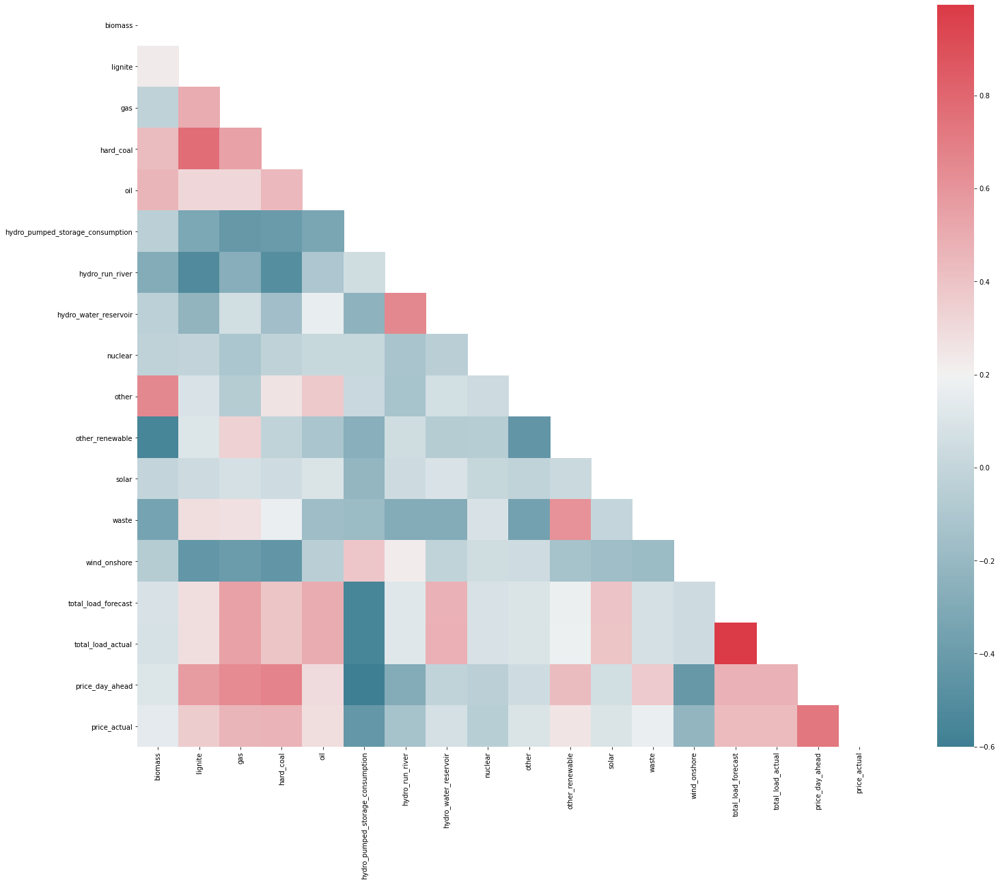

In [240]:
f, ax = plt.subplots(figsize=(30,20)) 
sns.heatmap(energy.corr() , mask = np.triu(np.ones_like(energy.corr(), dtype = bool)), 
            cmap=sns.diverging_palette(220, 10, as_cmap=True), square=True, ax=ax) 


Se observa que en general las variables no presentan demasiada correlación. 

Una excepción a esto son las variables 'total_load_actual' y 'total_load_forecast', lo cual tiene sentido teniendo en cuenta que se trata de la previsión de producción y la producción real. En este punto merece la pena señalar que la correlación entre las variables 'price_day_ahead' y 'price_actual', que representan el precio previsto y el precio real de la energía, no es tan alta como entre las variables arriba mencionadas, lo que indica que la previsión que se hace de la generación en mejor que la del precio.

Por otra parte, otras correlaciones destacables se producen entre las fuentes de energía fósil y las renovables, en este caso de tipo negativo. Esto es debido a que la producción comienza siempre por las renovables y en la parte que falte para alcanzar la demanda se genera con fuentes de energía fósiles.

En cuanto a las correlaciones entre precio y producción, se encuentran entorna a 0.5 .

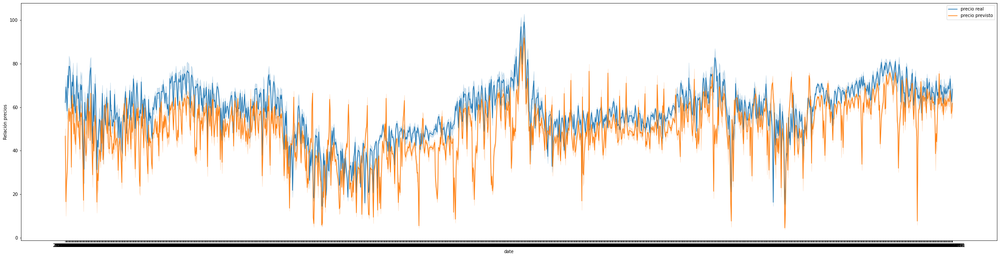

In [241]:
fig, ax = plt.subplots(nrows = 1, figsize = (40, 10)) 

ax = sns.lineplot(x = 'date', y = 'price_actual', data = energy, label = 'precio real') 
ax = sns.lineplot(x = 'date', y = 'price_day_ahead', data = energy, label = 'precio previsto') 
ax.set(ylabel = 'Relación precios') 
ax.legend() 
plt.show() 

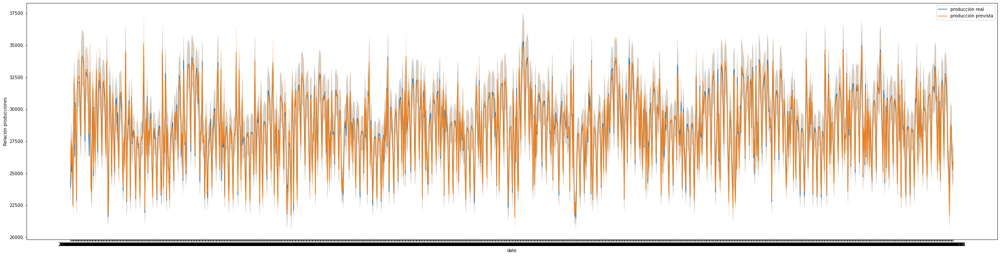

In [242]:
fig, ax = plt.subplots(nrows = 1, figsize = (40, 10)) 

ax = sns.lineplot(x = 'date', y = 'total_load_actual', data = energy, label = 'producción real') 
ax = sns.lineplot(x = 'date', y = 'total_load_forecast', data = energy, label = 'producción prevista') 
ax.set(ylabel = 'Relación producciones') 
ax.legend() 
plt.show() 

En los gráficos superiores se observa la evolución de los precios y de la producción a lo largo del tiempo. Por un lado, se observa que los precios son más estables que la producción y por otro, se confirma lo visto anteriormente en las correlaciones, al estar las lineas de producción real y estimada prácticamente superpuestas mientras las de los precios real y previsto presentan más diferencias.

In [203]:
pasc = energy.price_actual - energy.price_actual.mean() 
pdasc = energy.price_day_ahead - energy.price_day_ahead.mean()
tlasc = energy.total_load_actual - energy.total_load_actual.mean() 
tlfsc = energy.total_load_forecast - energy.total_load_forecast.mean() 

In [208]:
energysc = pd.DataFrame({ 'scdate': energy.date, 'pasc': pasc,'pdasc': pdasc, 'tlasc': tlasc, 'tlfsc': tlfsc}) 

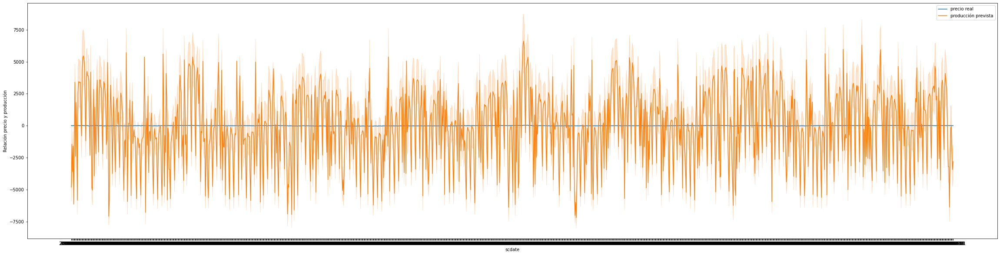

In [210]:
fig, ax = plt.subplots(nrows = 1, figsize = (40, 10)) 

ax = sns.lineplot(x = 'scdate', y = 'pasc', data = energysc, label = 'precio real') 
ax = sns.lineplot(x = 'scdate', y = 'tlasc', data = energysc, label = 'producción prevista') 
ax.set(ylabel = 'Relación precio y producción') 
ax.legend() 
plt.show()

### Referencias
https://cunef.instructure.com/courses/3338/files/224147?module_item_id=78349&fd_cookie_set=1

https://www.kaggle.com/nicholasjhana/energy-consumption-generation-prices-and-weather?select=energy_dataset.csv

https://towardsdatascience.com/exploratory-data-analysis-eda-python-87178e35b14

https://anaconda.org/conda-forge